### Adding libraries

* gym for environment simulation
* matplotlin for plotting results
* keras-rl2 for implementation of reinforcement learning

In [1]:
import numpy as np
import gymnasium as gym
import matplotlib.pyplot as plt

from env import Dataset_A_env

### Loading environment for Dataset_A
* Loading dataset and saving shuffled and splitted train and test(30 percent) data
* Giving +1 reward for True predictions and -1 for wrong predictions (considering discrete integer actions as our predictions)
* plotting cumulative reward function

Table 4
The information of four different structures.
No. Layer type Structure-1 Structure-2 Structure-3 Structure-4
* 1 | The input layer..................| 784 | 784 | 784 | 784
* 2 Convolution_1......................| 20,4,1, same | 25,3,1, same | 30,5,1, same | 32,3,1, same
* 3 Max-pooling_1.....................| – | – | – | –
* 4 Convolution_2......................| 40,4,1, same | 50,3,1, same | 60,5,1, same | 64,3,1, same
* 5 Max-pooling_2.....................| – | – | – | –
* 6 Flatten......................................| – | – | – | –
* 7 Fully-connected...................| 128 | 128 | 128 | 128
* 8 Dropout...................................| 0.1 | 0.1 | 0.1 | 0.1
* 9 The output layer..................| LS | LS | LS | LS


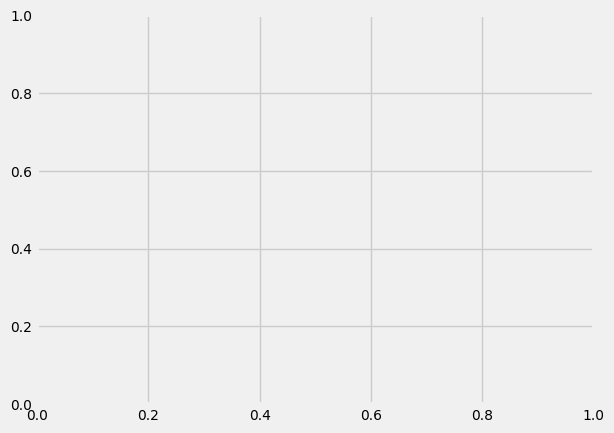

In [4]:
# Building the environment
env1 = Dataset_A_env()
np.random.seed(0)
num_actions = 10 #env.action_space.n

### Creating Deep Q-network arcutecture for first model based on structure 4

In [5]:
from stable_baselines3.common.env_checker import check_env
check_env(env=env1)

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from stable_baselines3.common.callbacks import BaseCallback
import pandas as pd

class MyCallback(BaseCallback):
    def __init__(self, verbose=0):
        super(MyCallback, self).__init__(verbose)
        self.episode_rewards = []
        self.t = []

    def _on_step(self) -> bool:
        if len(self.model.ep_info_buffer)==0:
            return True
        # Log episode rewards during training
        self.episode_rewards.append(self.model.ep_info_buffer[-1]['r'])
        self.t.append(self.model.ep_info_buffer[0]['t'])
        self.model.episode_rewards = self.episode_rewards
        self.model.t = self.t
        return True  # continue training


In [8]:
import gymnasium as gym
import torch as th
import torch.nn as nn
import torch
import torch.nn.functional as F
from stable_baselines3 import DQN
from stable_baselines3.common.torch_layers import BaseFeaturesExtractor
from stable_baselines3.dqn.policies import DQNPolicy
class CustomResNetFeaturesExtractor(BaseFeaturesExtractor):
    def __init__(self, observation_space: gym.spaces.Box, features_dim: int = 128):
        super(CustomResNetFeaturesExtractor, self).__init__(observation_space, features_dim)
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1).to('cuda:0')#.to(torch.float64)
        self.pool = nn.MaxPool2d(2, 2).to(torch.float64).to('cuda:0')
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1).to('cuda:0')#.to(torch.float64)
        self.fc1 = nn.Linear(64 * 7 * 7, 128).to('cuda:0')#.to(torch.float64)
        self.dropout = nn.Dropout(0.5).to('cuda:0')#.to(torch.float64)
        # self.fc2 = nn.Linear(128, 28*28).to('cuda:0')#.to(torch.float64)

    def forward(self, x):
        x = x.reshape([-1,1,28,28])#.to(torch.float64)
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        x = x.view(-1, 64 * 7 * 7)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        # x = self.fc2(x)
        return x
        # return F.log_softmax(x, dim=1)

class CustomDQNPolicy(DQNPolicy):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

In [32]:
env = env1
obs_space = env.observation_space
# Define the policy_kwargs to use the features extractor
policy_kwargs = dict(
    features_extractor_class=CustomResNetFeaturesExtractor,
    features_extractor_kwargs=dict(features_dim=128),
    net_arch=[]
)

# Create the DQN model
model = DQN(
    policy=CustomDQNPolicy,
    env=env,
    policy_kwargs=policy_kwargs,
    verbose=1,
    buffer_size=10000,
    learning_rate=1e-4,
    batch_size=128*8,
    gamma=0.99,
    train_freq=4,
    gradient_steps=1,
    target_update_interval=1000,
)

callback = MyCallback()

# Train the model
model.learn(total_timesteps=100000, callback=callback)

# Save the model
model.save("test")

# Don't forget to close the environment
env.close()

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.5     |
|    exploration_rate | 1        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 200      |
|    time_elapsed     | 0        |
|    total_timesteps  | 4        |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.5     |
|    exploration_rate | 0.999    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 222      |
|    time_elapsed     | 0        |
|    total_timesteps  | 8        |
----------------------------------


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.667   |
|    exploration_rate | 0.999    |
| time/               |          |
|    episodes         | 12       |
|    fps              | 190      |
|    time_elapsed     | 0        |
|    total_timesteps  | 12       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.75    |
|    exploration_rate | 0.998    |
| time/               |          |
|    episodes         | 16       |
|    fps              | 190      |
|    time_elapsed     | 0        |
|    total_timesteps  | 16       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.8     |
|    exploration_rate | 0.998    |
| time/               |          |
|    episodes       

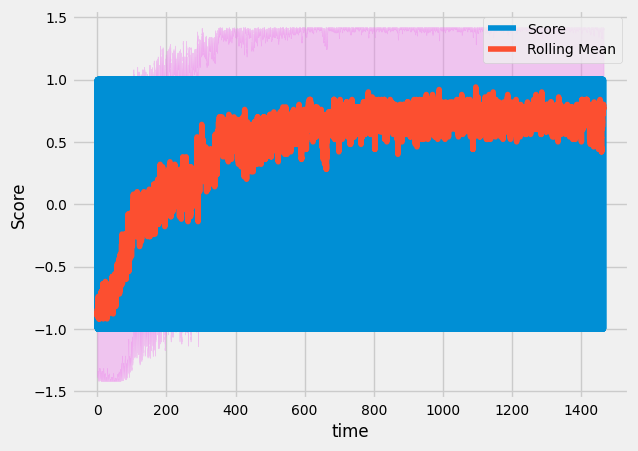

In [33]:
window = 100
reward_sum = model.episode_rewards
rolling_mean = pd.Series(reward_sum).rolling(window).mean()
std = pd.Series(reward_sum).rolling(window).std()

plt.plot(model.t, reward_sum)
plt.plot(model.t, rolling_mean)
plt.fill_between(model.t, rolling_mean-std, rolling_mean+std, color='violet', alpha=0.4)#range(len(reward_sum))

plt.grid('on')
plt.xlabel('time')#Episode
plt.ylabel('Score')
plt.legend(['Score', 'Rolling Mean'])

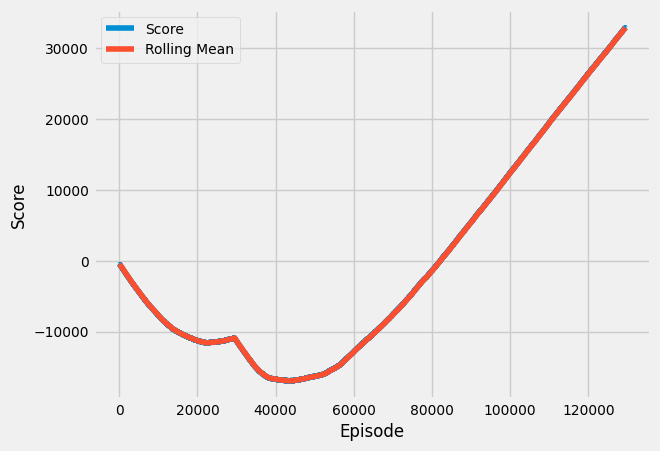

In [34]:
env1.render()

In [15]:
# model = DQN.load("test", print_system_info=True)

== CURRENT SYSTEM INFO ==
- OS: Windows-10-10.0.19045-SP0 10.0.19045
- Python: 3.11.7
- Stable-Baselines3: 2.3.0a1
- PyTorch: 2.1.2+cu118
- GPU Enabled: True
- Numpy: 1.26.3
- Cloudpickle: 3.0.0
- Gymnasium: 0.29.1

== SAVED MODEL SYSTEM INFO ==
- OS: Windows-10-10.0.19045-SP0 10.0.19045
- Python: 3.11.7
- Stable-Baselines3: 2.3.0a1
- PyTorch: 2.1.2+cu118
- GPU Enabled: True
- Numpy: 1.26.3
- Cloudpickle: 3.0.0
- Gymnasium: 0.29.1



#### Transfer learning

In [18]:
class CustomResNetFeaturesExtractor(BaseFeaturesExtractor):
    def __init__(self, observation_space: gym.spaces.Box, features_dim: int = 128):
        super(CustomResNetFeaturesExtractor, self).__init__(observation_space, features_dim)
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1).to('cuda:0')#.to(torch.float64)
        self.pool = nn.MaxPool2d(2, 2).to(torch.float64).to('cuda:0')
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1).to('cuda:0')#.to(torch.float64)
        self.conv3 = nn.Conv2d(64, 32, kernel_size=3, padding=1).to('cuda:0')
        self.conv4 = nn.Conv2d(32, 64, kernel_size=3, padding=1).to('cuda:0')

        self.fc1 = nn.Linear(64 * 1 * 1, 128).to('cuda:0')#.to(torch.float64)#(64 * 7 * 7, 128)
        self.dropout = nn.Dropout(0.5).to('cuda:0')#.to(torch.float64)
        # self.fc2 = nn.Linear(128, 28*28).to('cuda:0')#.to(torch.float64)

    def forward(self, x):
        x = x.reshape([-1,1,28,28])#.to(torch.float64)
        
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        
        x = F.relu(self.conv3(x))
        x = self.pool(x)
        x = F.relu(self.conv4(x))
        x = self.pool(x)
        x = x.view(-1, 64 * 1 * 1)# 64 * 7 * 7
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        # x = self.fc2(x)
        return x
        # return F.log_softmax(x, dim=1)

class CustomDQNPolicy(DQNPolicy):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -1       |
|    exploration_rate | 1        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 148      |
|    time_elapsed     | 0        |
|    total_timesteps  | 4        |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -1       |
|    exploration_rate | 0.999    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 178      |
|    time_elapsed     | 0        |
|    total_timesteps  | 8        |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 1        |
|    ep_rew_mean      | -0.833

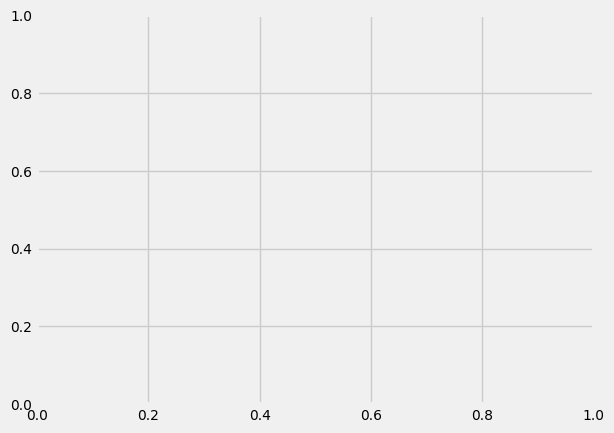

In [19]:
env = Dataset_A_env()
obs_space = env.observation_space

# Define the policy_kwargs to use the features extractor
policy_kwargs = dict(
    features_extractor_class=CustomResNetFeaturesExtractor,
    features_extractor_kwargs=dict(features_dim=128),
    net_arch=[]
)

# Create the DQN model
model2 = DQN(
    policy=CustomDQNPolicy,
    env=env,
    policy_kwargs=policy_kwargs,
    verbose=1,
    buffer_size=10000,
    learning_rate=1e-4,
    batch_size=128,
    gamma=0.99,
    train_freq=4,
    gradient_steps=1,
    target_update_interval=1000,
)
model2.policy.q_net.features_extractor.conv1 = model.policy.q_net.features_extractor.conv1
model2.policy.q_net.features_extractor.maxpool = model.policy.q_net.features_extractor.pool
model2.policy.q_net.features_extractor.conv2 = model.policy.q_net.features_extractor.conv2

model2.policy.q_net_target.features_extractor.conv1 = model.policy.q_net_target.features_extractor.conv1
model2.policy.q_net_target.features_extractor.maxpool = model.policy.q_net_target.features_extractor.pool
model2.policy.q_net_target.features_extractor.conv2 = model.policy.q_net_target.features_extractor.conv2


model2.policy.q_net.features_extractor.conv1.requires_grad = False
model2.policy.q_net.features_extractor.conv2.requires_grad = False
model2.policy.q_net.features_extractor.pool.requires_grad = False

model2.policy.q_net_target.features_extractor.conv1.requires_grad = False
model2.policy.q_net_target.features_extractor.conv2.requires_grad = False
model2.policy.q_net_target.features_extractor.pool.requires_grad = False

callback = MyCallback()

# Train the model
model2.learn(total_timesteps=100000, callback=callback)

# Save the model
model2.save("test2")

# Don't forget to close the environment
env.close()

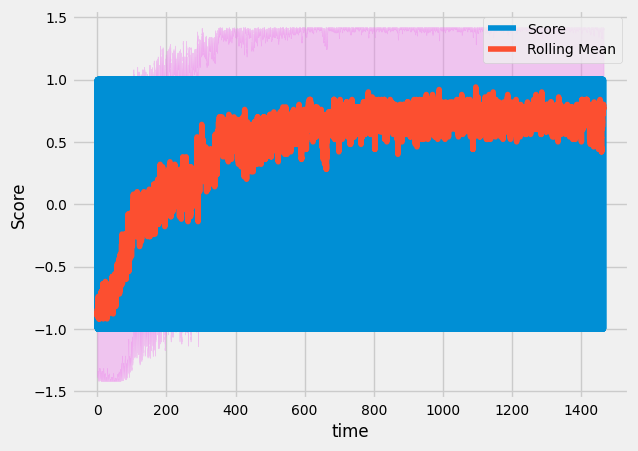

In [20]:
window = 100
reward_sum = model.episode_rewards
rolling_mean = pd.Series(reward_sum).rolling(window).mean()
std = pd.Series(reward_sum).rolling(window).std()

plt.plot(model.t, reward_sum)
plt.plot(model.t, rolling_mean)
plt.fill_between(model.t, rolling_mean-std, rolling_mean+std, color='violet', alpha=0.4)#range(len(reward_sum))

plt.grid('on')
plt.xlabel('time')#Episode
plt.ylabel('Score')
plt.legend(['Score', 'Rolling Mean'])

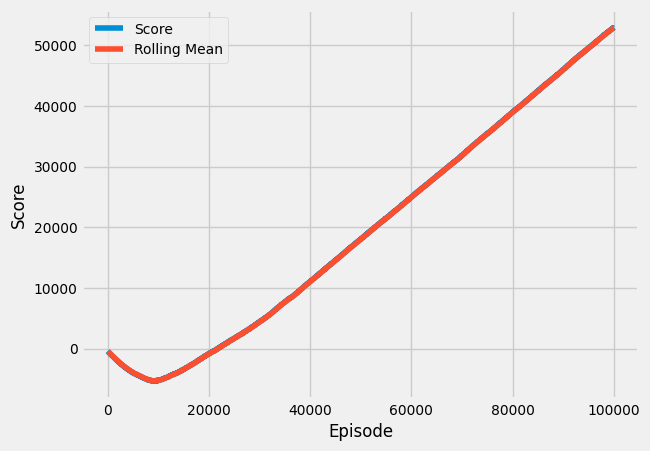

In [21]:
env.render()

In [9]:
model2 = DQN.load("test2", print_system_info=True)

== CURRENT SYSTEM INFO ==
- OS: Windows-10-10.0.19045-SP0 10.0.19045
- Python: 3.11.7
- Stable-Baselines3: 2.3.0a1
- PyTorch: 2.1.2+cu118
- GPU Enabled: True
- Numpy: 1.26.3
- Cloudpickle: 3.0.0
- Gymnasium: 0.29.1

== SAVED MODEL SYSTEM INFO ==
- OS: Windows-10-10.0.19045-SP0 10.0.19045
- Python: 3.11.7
- Stable-Baselines3: 2.3.0a1
- PyTorch: 2.1.2+cu118
- GPU Enabled: True
- Numpy: 1.26.3
- Cloudpickle: 3.0.0
- Gymnasium: 0.29.1



In [14]:
import scipy.io as sc
data2 = sc.loadmat('data2.mat')['data2']
DE = data2['DE'][0][0]
FE = data2['FE'][0][0]
label = data2['label'][0][0]

X = np.double(DE.reshape([-1, 784]))
Y = np.int64(label.reshape([-1, 784]).mean(1))

MAX = X.max()
MIN = X.min()
X = (X - MIN) / (MAX - MIN)

In [35]:
TrainData = np.load('TrainData.npy', allow_pickle = True).reshape([-1])[0]
X_train = TrainData['x']
Y_train = TrainData['y']

TestData = np.load('TestData.npy', allow_pickle = True).reshape([-1])[0]
X_test = TestData['x']
Y_test = TestData['y']

In [38]:
Y_hat_test = np.zeros(Y_test.shape)
for i in range(X_test.shape[0]):
    Y_hat_test[i] = model2.predict(X_test[i].reshape([1,-1]))[0][0]
Y_hat_train = np.zeros(Y_train.shape)
for i in range(X_train.shape[0]):
    Y_hat_train[i] = model2.predict(X_train[i].reshape([1,-1]))[0][0]

In [39]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import pandas as pd
cm_train = confusion_matrix(Y_train, Y_hat_train)
cm_df_train = pd.DataFrame(cm_train)

cm_test = confusion_matrix(Y_test, Y_hat_test)
cm_df_test = pd.DataFrame(cm_test)

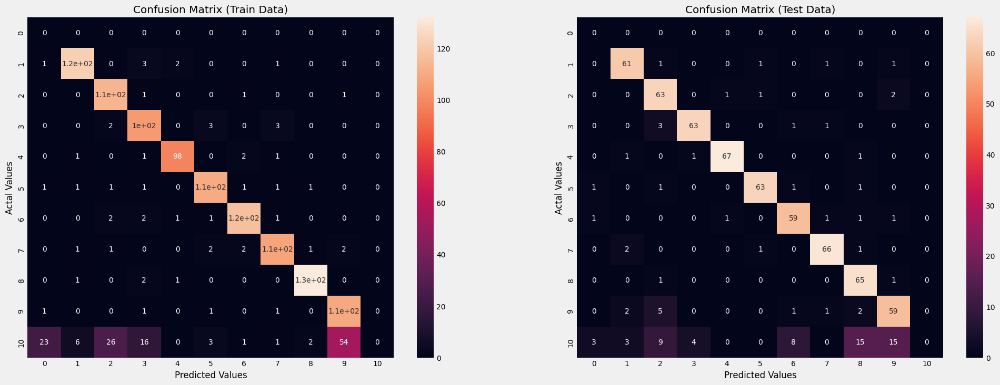

In [46]:
plt.figure(figsize=(22,8))
plt.subplot(1,2,1)
sns.heatmap(cm_df_train, annot=True)
plt.title('Confusion Matrix (Train Data)')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.subplot(1,2,2)
sns.heatmap(cm_df_test, annot=True)
plt.title('Confusion Matrix (Test Data)')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.savefig('ST3_results.png', dpi = 400)
plt.show()